In [1]:
import math 
import meep as mp 

from photonic_crystal import CrystalSlab, Crystal2D

# Define the geometry of the photonic crystal
#geometry = CrystalSlab.basic_geometry()
geometry = CrystalSlab.ellipsoid_geometry(e1= 0.4, e2 = 0.6, 
                                          eps_diag = mp.Vector3(4.574, 4.890, 4.890),
                                          eps_offdiag = mp.Vector3(0.0, 0.0, 0.0), 
) 
num_bands = 8
interp = 6
resolution = 16
periods = 3
lattice_type = "square"
pickle_id = "test_crystal_slab_high_res_2"


#Create the photonic crystal slab
slab = CrystalSlab(geometry = geometry,
                    num_bands = num_bands,
                    interp = interp,
                    resolution = resolution,
                    periods = periods,
                    lattice_type = lattice_type,
                    pickle_id = pickle_id,
                    k_point_max=0.4)


Using MPI version 3.1, 1 processes


In [2]:
import pickle
slab = pickle.load(open(f"test_crystal_slab_high_res_2.pickle", "rb"))

In [3]:

slab.set_solver()
#slab.run_simulation(runner="run_zeven")
#slab.run_simulation(runner="run_zodd")
fig_bands = slab.plot_bands_interactive("zeven", color = "blue")

fig_bands = slab.plot_bands_interactive("zodd", fig = fig_bands, color="red")
fig_bands.update_layout(height=800, width=600)
fig_bands.show()

fig_eps = slab.plot_epsilon_interactive(periods=3)
fig_eps.update_layout(height=800, width=600)
fig_eps.show()


(48, 48, 63)


In [4]:
import pickle
with open(f"{slab.pickle_id}.pickle", "wb") as f:
    pickle.dump(slab, f)

In [4]:
# Data of all the modes

for i, mode in enumerate(slab.modes):
    if mode["polarization"] == "zodd":
        print(f'mode {i}: k:{mode["k_point"]} freq:{mode["freq"]}')



mode 120: k:Vector3<0.4, 0.0, 0.0> freq:0.3523531592387489
mode 121: k:Vector3<0.4, 0.0, 0.0> freq:0.43566511596079566
mode 122: k:Vector3<0.4, 0.0, 0.0> freq:0.4531448426656013
mode 123: k:Vector3<0.4, 0.0, 0.0> freq:0.4671105139021294
mode 124: k:Vector3<0.4, 0.0, 0.0> freq:0.5555001543824308
mode 125: k:Vector3<0.4, 0.0, 0.0> freq:0.574873429862872
mode 126: k:Vector3<0.4, 0.0, 0.0> freq:0.6022540031658646
mode 127: k:Vector3<0.4, 0.0, 0.0> freq:0.6155369754271971
mode 128: k:Vector3<0.34285714285714286, 0.0, 0.0> freq:0.31041658461099764
mode 129: k:Vector3<0.34285714285714286, 0.0, 0.0> freq:0.3914435138783331
mode 130: k:Vector3<0.34285714285714286, 0.0, 0.0> freq:0.41031273520990164
mode 131: k:Vector3<0.34285714285714286, 0.0, 0.0> freq:0.4934811228280314
mode 132: k:Vector3<0.34285714285714286, 0.0, 0.0> freq:0.532749106638451
mode 133: k:Vector3<0.34285714285714286, 0.0, 0.0> freq:0.5453612731351719
mode 134: k:Vector3<0.34285714285714286, 0.0, 0.0> freq:0.6280320596192935
mo

In [5]:
t_mode = slab.modes[182]
t_k_point = t_mode["k_point"]
t_freq = t_mode["freq"]
t_modes = slab.look_for_mode(polarization="zodd", freq=t_freq, k_point=t_k_point, freq_tolerance=0.01)
print(len(t_modes))

3


In [6]:
# Now call the function with your parameters
fig_e, fig_h,  = slab.plot_field("zodd", t_k_point, t_freq, 0.01, periods=3, component=2, quantity="real", colorscale='RdBu')
fig_e.show()

# h_field has no component z
dc, fig_h_y,  = slab.plot_field("zodd", t_k_point, t_freq, 0.01, periods=3, component=1, quantity="real", colorscale='RdBu')
fig_h_y.show()

dc, fig_h_x,  = slab.plot_field("zodd", t_k_point, t_freq, 0.01, periods=3, component=0, quantity="real", colorscale='RdBu')    
fig_h_x.show()



3
3


3
3


3
3


In [7]:
# Now we consider the modes with k towards y

t_mode = slab.modes[198]
t_k_point = t_mode["k_point"]
t_freq = t_mode["freq"] 
print(f"t_freq: {t_freq}, t_k_point: {t_k_point}")

t_modes = slab.look_for_mode(polarization="zodd", freq=t_freq, k_point=t_k_point, freq_tolerance=0.08)
print(len(t_modes))
for mode in t_modes:
    print(f'k:{mode["k_point"]} freq:{mode["freq"]}')

t_freq: 0.6278991492092693, t_k_point: Vector3<0.0, 0.1142857142857143, 0.0>
3
k:Vector3<0.0, 0.1142857142857143, 0.0> freq:0.5807943478474249
k:Vector3<0.0, 0.1142857142857143, 0.0> freq:0.6278991492092693
k:Vector3<0.0, 0.1142857142857143, 0.0> freq:0.6426865151582245


In [8]:
#Let's plot the field of the mode fields

fig_e_x, fig_h_x,  = slab.plot_field( "zodd", t_k_point, t_freq, 0.08, periods=3, component=0, quantity="abs", colorscale='RdBu')
fig_e_x.show()
fig_h_x.show()


fig_e_y, fig_h_y,  = slab.plot_field("zodd", t_k_point, t_freq, 0.08, periods=3, component=1, quantity="abs", colorscale='RdBu')
fig_e_y.show()
fig_h_y.show()

fig_e_z, fig_h_z,  = slab.plot_field("zodd", t_k_point, t_freq, 0.08, periods=3, component=2, quantity="abs", colorscale='RdBu')
fig_e_z.show()
fig_h_z.show()





3
3


3
3


3
3


In [39]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

def combine_figures(*figures, colorscale="Viridis", subtitles):
    """
    Combine an arbitrary number of Plotly figures into a single row of subplots,
    inheriting the dropdown menu from the first figure, applying a universal colorscale
    based on Heatmap traces, and retaining each figure's individual title.
    
    Parameters:
    - figures: Plotly figure objects (e.g., go.Figure) to be combined.
    - colorscale: The colorscale to apply universally to all traces. Default is 'Viridis'.

    Returns:
    - A Plotly figure with each input figure in a separate subplot, using a consistent colorscale
      and color limits, and with individual titles for each subplot.
    """
    # Number of figures determines the number of columns
    num_figures = len(figures)
    
    # Calculate global color limits across all Heatmap traces only
    global_min = float('inf')
    global_max = float('-inf')
    for single_fig in figures:
        for trace in single_fig.data:
            # Only consider Heatmap traces for color limits
            if isinstance(trace, go.Heatmap):
                global_min = min(global_min, trace.z.min())
                global_max = max(global_max, trace.z.max())
    
    # Create a subplots figure with one row and as many columns as there are figures
    fig = make_subplots(rows=1, cols=num_figures, subplot_titles=subtitles)

    # Add all traces from each figure to the corresponding subplot, applying the universal colorscale and limits
    for i, single_fig in enumerate(figures, start=1):
        for trace in single_fig.data:
            # Apply colorscale and global limits only to Heatmap traces
            if isinstance(trace, go.Heatmap):
                trace.update(colorscale=colorscale, zmin=global_min, zmax=global_max)
                trace.update(coloraxis="coloraxis")  # Link to global coloraxis
            fig.add_trace(trace, row=1, col=i)

    # Set a global color axis with consistent limits for Heatmap traces
    fig.update_layout(
        updatemenus=figures[0].layout.updatemenus,  # Directly copy the dropdown menu from the first figure
        title="Combined Figures with Universal Colorscale (Based on Heatmaps)",
        coloraxis=dict(colorscale=colorscale, cmin=global_min, cmax=global_max)  # Apply global color limits
    )
    
    return fig

# Usage example:
# combined_fig = combine_figures(go_fig1, go_fig2, go_fig3, colorscale="Cividis")
# combined_fig.show()


In [100]:

# Usage example:
combined_fig_e = combine_figures(fig_e_x, fig_e_y, fig_e_z, colorscale="RdBu")
combined_fig_e.show()

combined_fig_h = combine_figures(fig_h_x, fig_h_y, fig_h_z, colorscale="RdBu")
combined_fig_h.show()



In [9]:
from photonic_crystal import suppress_output
import plotly.graph_objs as go
import numpy as np
import meep as mp
from meep import mpb



In [10]:
from photonic_crystal import suppress_output
import plotly.graph_objs as go
import numpy as np
import meep as mp
from meep import mpb
from plotly.subplots import make_subplots

def plot_field_components(self,
                          target_polarization,
                          target_k_point,
                          target_frequency,
                          frequency_tolerance=0.01,
                          k_point_max_distance=None,
                          periods: int = 1,
                          quantity: str = "real",
                          colorscale: str = 'RdBu',
                          ):
    """
    Plot the field components (Ex, Ey, Ez) and (Hx, Hy, Hz) for specific modes with consistent color scales.

    Args:
        target_polarization (str): The polarization of the target mode.
        target_k_point (tuple): The k-point of the target mode.
        target_frequency (float): The frequency of the target mode.
        frequency_tolerance (float): The tolerance for frequency similarity.
        periods (int): The number of periods to extract. Default is 1.
        quantity (str): The quantity to plot ('real', 'imag', or 'abs'). Default is 'real'.
        colorscale (str): The colorscale to use for the plot. Default is 'RdBu'.

    Returns:
        tuple: A tuple containing the electric field figure and the magnetic field figure.
    """

    target_modes = self.look_for_mode(target_polarization, target_k_point, target_frequency,
                                      freq_tolerance=frequency_tolerance, k_point_max_distance=k_point_max_distance)
    print(f"Number of target modes found: {len(target_modes)}")

    with suppress_output():
        self.run_dumb_simulation()
        md = mpb.MPBData(rectify=True, periods=periods, lattice=self.ms.get_lattice())
        eps = md.convert(self.ms.get_epsilon())

    z_points = eps.shape[2] // periods
    z_mid = eps.shape[2] // 2

    # Now take only epsilon in the center of the slab
    eps = eps[..., z_mid]
    # Calculate the midpoint between min and max of the permittivity (eps)
    min_eps, max_eps = np.min(eps), np.max(eps)
    midpoint = (min_eps + max_eps) / 2  # The level to be plotted

    fig_e = make_subplots(rows=1, cols=3, subplot_titles=("Ex", "Ey", "Ez"))
    fig_h = make_subplots(rows=1, cols=3, subplot_titles=("Hx", "Hy", "Hz"))
    dropdown_buttons_e = []
    dropdown_buttons_h = []

    # For each mode, calculate separate min and max values for Ex, Ey, Ez (and similarly Hx, Hy, Hz)
    for i, mode in enumerate(target_modes):
        # Get field arrays for this mode
        e_field_array = mpb.MPBArray(mode["e_field"], lattice=self.ms.get_lattice(), kpoint=mode["k_point"])
        h_field_array = mpb.MPBArray(mode["h_field"], lattice=self.ms.get_lattice(), kpoint=mode["k_point"])

        # Extract field components in the center of the slab
        e_field_x = e_field_array[..., z_points // 2, 0]  # Shape (Nx, Ny)
        e_field_y = e_field_array[..., z_points // 2, 1]  # Shape (Nx, Ny)
        e_field_z = e_field_array[..., z_points // 2, 2]  # Shape (Nx, Ny)
        h_field_x = h_field_array[..., z_points // 2, 0]  # Shape (Nx, Ny)
        h_field_y = h_field_array[..., z_points // 2, 1]  # Shape (Nx, Ny)
        h_field_z = h_field_array[..., z_points // 2, 2]  # Shape (Nx, Ny)

        with suppress_output():
            e_field_x = md.convert(e_field_x)
            e_field_y = md.convert(e_field_y)
            e_field_z = md.convert(e_field_z)
            h_field_x = md.convert(h_field_x)
            h_field_y = md.convert(h_field_y)
            h_field_z = md.convert(h_field_z)

        e_field = np.stack([e_field_x, e_field_y, e_field_z], axis=-1)
        h_field = np.stack([h_field_x, h_field_y, h_field_z], axis=-1)                                    

        # Select quantity to display (real, imag, abs)
        if quantity == "real":
            e_field = np.real(e_field)
            h_field = np.real(h_field)
        elif quantity == "imag":
            e_field = np.imag(e_field)
            h_field = np.imag(h_field)
        elif quantity == "abs":
            e_field = np.abs(e_field)
            h_field = np.abs(h_field)
        else:
            raise ValueError("Invalid quantity. Choose 'real', 'imag', or 'abs'.")

        # Calculate the component-specific min/max for E and H fields of this mode
        e_min = np.min(e_field)
        e_max = np.max(e_field)
        h_min = np.min(h_field)
        h_max = np.max(h_field)

        # Components of the E and H fields
        Ex, Ey, Ez = e_field[..., 0], e_field[..., 1], e_field[..., 2]
        Hx, Hy, Hz = h_field[..., 0], h_field[..., 1], h_field[..., 2]

        # Define visibility settings per mode, including contours as always visible
        visible_status_e = [False] * (len(target_modes) * 6)  # 3 components per mode, with contour for each
        visible_status_h = [False] * (len(target_modes) * 6)
        # Make the contour visible by default

        


        # Make this mode's components and the corresponding contour visible in the initial layout 
        for j in range(6):
            visible_status_e[6*i + j] = True
            visible_status_h[6*i + j] = True


        # Add contour traces for permittivity to each subplot of fig_e and fig_h for this mode
        fig_e.add_trace(go.Contour(z=eps.T, contours=dict(start=midpoint, end=midpoint, size=0.1, coloring='none'), line=dict(color='black', width=2), showscale=False, opacity=0.7, showlegend=False, visible=True if i == len(target_modes)-1 else False), row=1, col=1)
        fig_e.add_trace(go.Contour(z=eps.T, contours=dict(start=midpoint, end=midpoint, size=0.1, coloring='none'), line=dict(color='black', width=2), showscale=False, opacity=0.7, showlegend=False, visible=True if i == len(target_modes)-1 else False), row=1, col=2)
        fig_e.add_trace(go.Contour(z=eps.T, contours=dict(start=midpoint, end=midpoint, size=0.1, coloring='none'), line=dict(color='black', width=2), showscale=False, opacity=0.7, showlegend=False, visible=True if i == len(target_modes)-1 else False), row=1, col=3)

        fig_h.add_trace(go.Contour(z=eps.T, contours=dict(start=midpoint, end=midpoint, size=0.1, coloring='none'), line=dict(color='black', width=2), showscale=False, opacity=0.7, showlegend=False, visible=True if i == len(target_modes)-1 else False), row=1, col=1)
        fig_h.add_trace(go.Contour(z=eps.T, contours=dict(start=midpoint, end=midpoint, size=0.1, coloring='none'), line=dict(color='black', width=2), showscale=False, opacity=0.7, showlegend=False, visible=True if i == len(target_modes)-1 else False), row=1, col=2)
        fig_h.add_trace(go.Contour(z=eps.T, contours=dict(start=midpoint, end=midpoint, size=0.1, coloring='none'), line=dict(color='black', width=2), showscale=False, opacity=0.7, showlegend=False, visible=True if i == len(target_modes)-1 else False), row=1, col=3)

        # Add Ex, Ey, Ez with shared colorbar limits for the E field of this mode
        fig_e.add_trace(go.Heatmap(z=Ex.T, colorscale=colorscale, showscale=False, zmin=e_min, zmax=e_max, visible=True if i == len(target_modes)-1 else False, zsmooth="best", opacity=0.8), row=1, col=1)
        fig_e.add_trace(go.Heatmap(z=Ey.T, colorscale=colorscale, showscale=False, zmin=e_min, zmax=e_max, visible=True if i == len(target_modes)-1 else False, zsmooth="best", opacity=0.8), row=1, col=2)
        fig_e.add_trace(go.Heatmap(z=Ez.T, colorscale=colorscale, showscale=True, colorbar=dict(title="E-field", len=0.75, thickness=15), zmin=e_min, zmax=e_max, visible=True if i == len(target_modes)-1 else False, zsmooth="best", opacity=0.8), row=1, col=3)

        # Add Hx, Hy, Hz with shared colorbar limits for the H field of this mode
        fig_h.add_trace(go.Heatmap(z=Hx.T, colorscale=colorscale, showscale=False, zmin=h_min, zmax=h_max, visible=True if i == len(target_modes)-1 else False, zsmooth="best", opacity=0.8), row=1, col=1)
        fig_h.add_trace(go.Heatmap(z=Hy.T, colorscale=colorscale, showscale=False, zmin=h_min, zmax=h_max, visible=True if i == len(target_modes)-1 else False, zsmooth="best", opacity=0.8), row=1, col=2)
        fig_h.add_trace(go.Heatmap(z=Hz.T, colorscale=colorscale, showscale=True, colorbar=dict(title="H-field", len=0.75, thickness=15), zmin=h_min, zmax=h_max, visible=True if i == len(target_modes)-1 else False, zsmooth="best", opacity=0.8), row=1, col=3)
        
        

        # Dropdown data for E-field
        k_point = mode["k_point"]
        freq = mode["freq"]
        polarization = mode["polarization"]
        mode_description = f"Mode {i + 1}<br>k = [{k_point[0]:0.2f}, {k_point[1]:0.2f}], freq={freq:0.3f}, polarization={polarization}"
        
        dropdown_buttons_e.append(
            dict(label=f"Mode {i + 1}",
                 method='update',
                 args=[{'visible': visible_status_e},
                       {'title': f"{mode_description}: {quantity} of E-field components"}]))

        dropdown_buttons_h.append(
            dict(label=f"Mode {i + 1}",
                 method='update',
                 args=[{'visible': visible_status_h},
                       {'title': f"{mode_description}: {quantity} of H-field components"}]))

    # Layout and color settings
    fig_e.update_layout(
        title=f"{mode_description}: {quantity} of E-field components",
        updatemenus=[dict(
            active=len(target_modes) - 1,
            buttons=dropdown_buttons_e)],
        coloraxis=dict(colorbar=dict(len=0.75)),
        width=1200, height=400,
        xaxis_showgrid=False, yaxis_showgrid=False,
        xaxis_zeroline=False, yaxis_zeroline=False,
        hovermode="closest"
    )

    fig_h.update_layout(
        title=f"{mode_description}: {quantity} of H-field components",
        updatemenus=[dict(
            active=len(target_modes) - 1,
            buttons=dropdown_buttons_h)],
        coloraxis=dict(colorbar=dict(len=0.75)),
        width=1200, height=400,
        xaxis_showgrid=False, yaxis_showgrid=False,
        xaxis_zeroline=False, yaxis_zeroline=False,
        hovermode="closest"
    )

    # Final adjustments
    fig_e.update_xaxes(showticklabels=False)
    fig_e.update_yaxes(showticklabels=False)
    fig_h.update_xaxes(showticklabels=False)
    fig_h.update_yaxes(showticklabels=False)

    fig_e.update_layout(yaxis_scaleanchor="x", yaxis_scaleratio=1)
    fig_h.update_layout(yaxis_scaleanchor="x", yaxis_scaleratio=1)
    fig_e.update_layout(yaxis2_scaleanchor="x2", yaxis2_scaleratio=1)
    fig_h.update_layout(yaxis2_scaleanchor="x2", yaxis2_scaleratio=1)
    fig_e.update_layout(yaxis3_scaleanchor="x3", yaxis3_scaleratio=1)
    fig_h.update_layout(yaxis3_scaleanchor="x3", yaxis3_scaleratio=1)


    fig_e.update_xaxes(title_text="X-axis", row=1, col=1)
    fig_e.update_yaxes(title_text="Y-axis", row=1, col=1)
    fig_e.update_xaxes(title_text="X-axis", row=1, col=2)
    fig_e.update_yaxes(title_text="Y-axis", row=1, col=2)
    fig_e.update_xaxes(title_text="X-axis", row=1, col=3)
    fig_e.update_yaxes(title_text="Y-axis", row=1, col=3)

    fig_h.update_xaxes(title_text="X-axis", row=1, col=1)
    fig_h.update_yaxes(title_text="Y-axis", row=1, col=1)
    fig_h.update_xaxes(title_text="X-axis", row=1, col=2)
    fig_h.update_yaxes(title_text="Y-axis", row=1, col=2)
    fig_h.update_xaxes(title_text="X-axis", row=1, col=3)
    fig_h.update_yaxes(title_text="Y-axis", row=1, col=3)

    return fig_e, fig_h


In [21]:
# real part of the field
print("Real part of the field components")
fig_e, fig_h = slab.plot_field_components("zodd", t_k_point, t_freq, 0.1, periods=10, quantity="abs", colorscale='RdBu')
fig_e.show()

print("Real part of the field components")
fig_e, fig_h = slab.plot_field_components("zodd", t_k_point, t_freq, 0.1, periods=1, quantity="abs", colorscale='RdBu')
fig_e.show()
#fig_h.show()

# # imaginary part of the field
# print("Imaginary part of the field")
# fig_e, fig_h = plot_field_components(slab, "zodd", t_k_point, t_freq, 0.1, periods=10, quantity="imag", colorscale='RdBu')
# fig_e.show()
# fig_h.show()

# # absolute value of the field
# print("Absolute value of the field")
# fig_e, fig_h = plot_field_components(slab, "zodd", t_k_point, t_freq, 0.1, periods=10, quantity="abs", colorscale='RdBu')
# fig_e.show()
# fig_h.show()





Real part of the field components
Number of target modes found: 3


Real part of the field components
Number of target modes found: 3


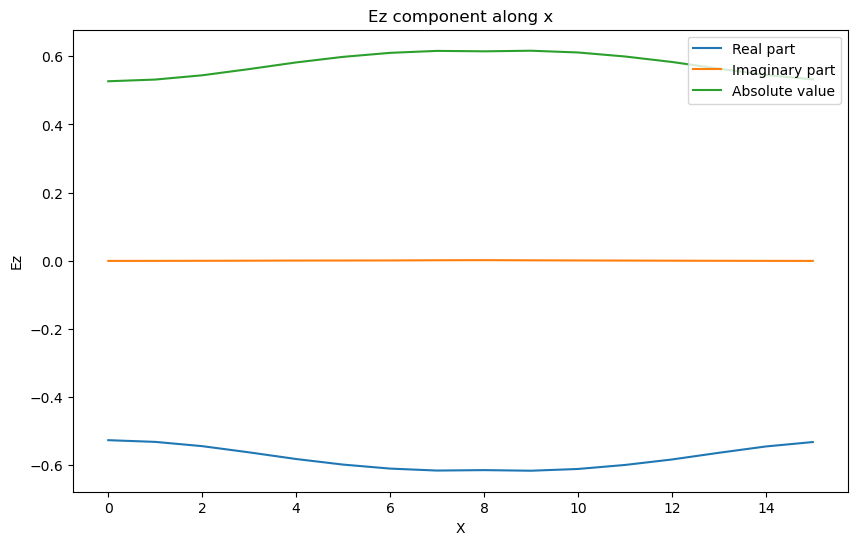

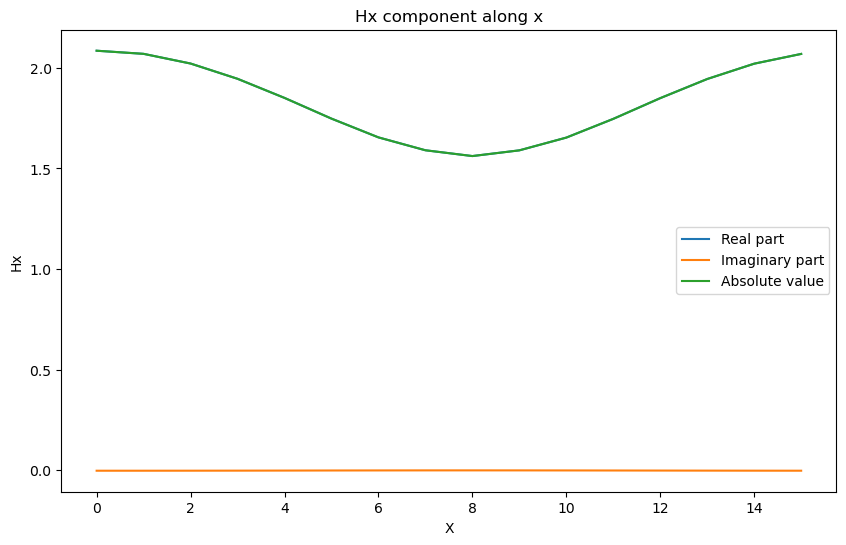

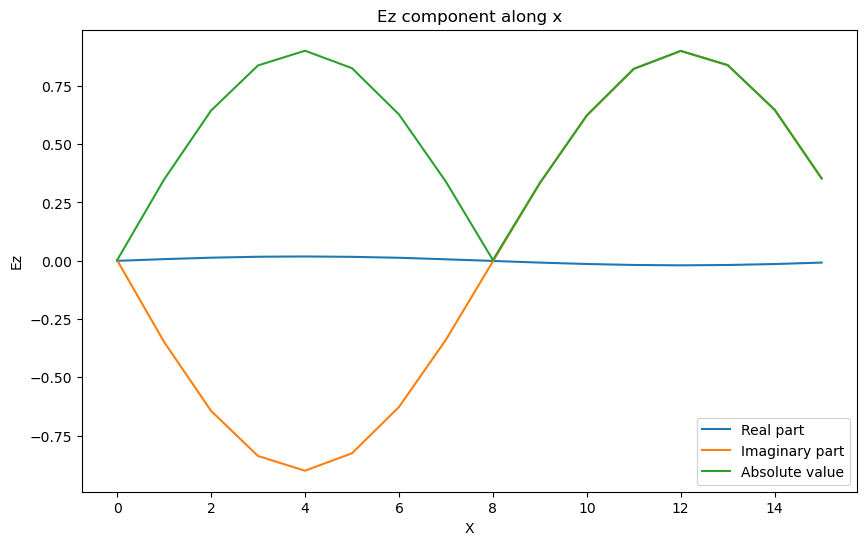

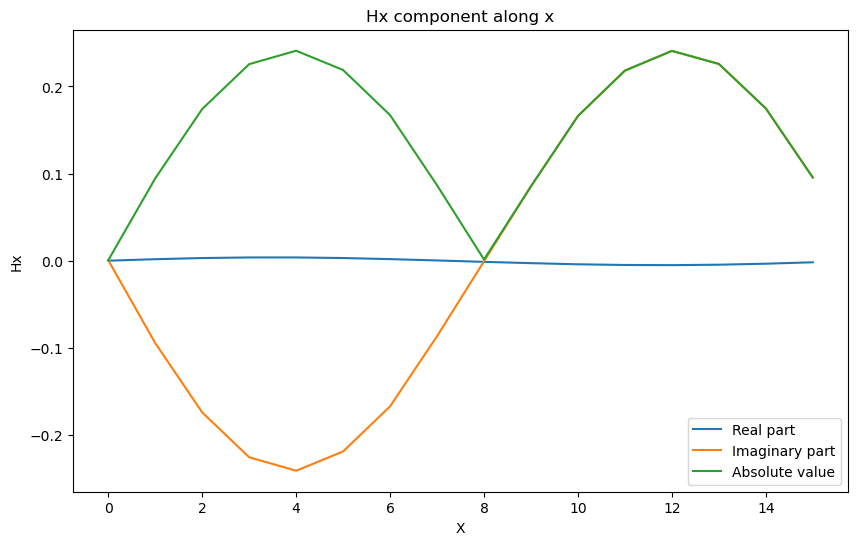

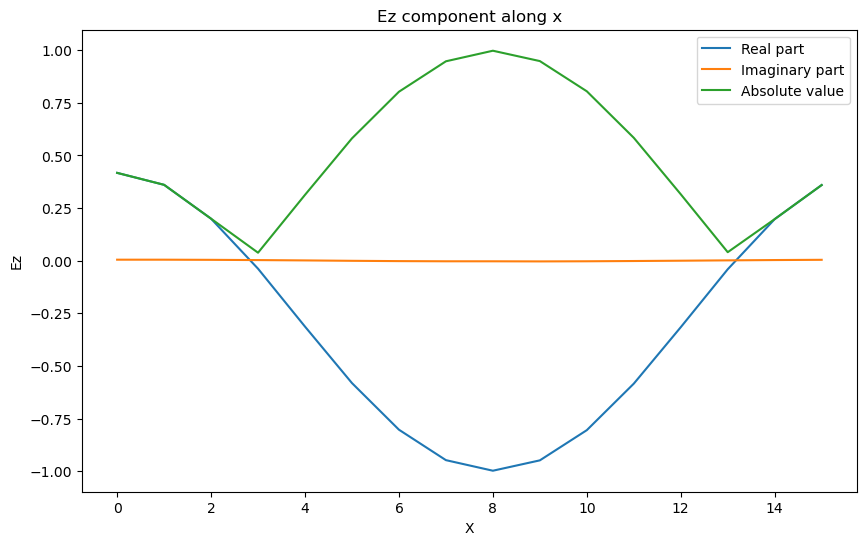

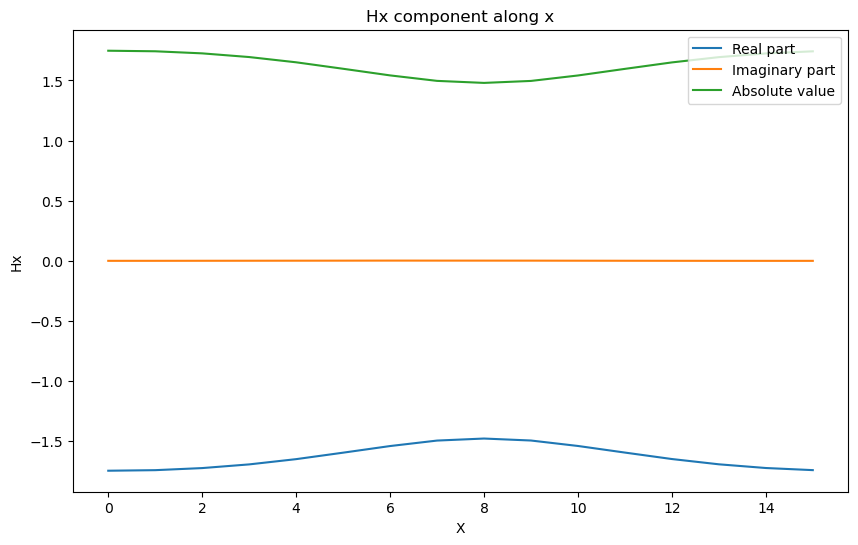

In [24]:
import matplotlib.pyplot as plt 
for mode in t_modes:

    # Prepare the figure with subplots: 1 row, 3 columns
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    # We are considering modes propagating along y
    
    # Electric field has only the z component
    Ez = mode["e_field"][:, 0, :, 2]
    # Now lets take the field in the middle of the slab
    Ez = Ez[:, Ez.shape[1]//2]
    # Now we plot the real part the imaginary part and the absolute value of the component along x
    axs[0].plot(np.arange(Ez.shape[0]), np.real(Ez), label='Real part')
    axs[0].plot(np.arange(Ez.shape[0]), np.imag(Ez), label='Imaginary part')
    axs[0].plot(np.arange(Ez.shape[0]), np.abs(Ez), label='Absolute value')
    axs[0].set_title('Ez component along x')
    axs[0].set_xlabel('X')
    axs[0].set_ylabel('Ez')
    axs[0].legend()

    # Magnetic field has the x and y components, we take only the one normal to the wave vector
    Hx = mode["h_field"][:, 0, :, 0]

    # Now lets take the field in the middle of the slab
    Hx = Hx[:, Hx.shape[1]//2]
    # Now we plot the real part, the imaginary part and the absolute value of the component along x
    axs[1].plot(np.arange(Hx.shape[0]), np.real(Hx), label='Real part')
    axs[1].plot(np.arange(Hx.shape[0]), np.imag(Hx), label='Imaginary part')
    axs[1].plot(np.arange(Hx.shape[0]), np.abs(Hx), label='Absolute value')
    axs[1].set_title('Hx component along x')
    axs[1].set_xlabel('X')
    axs[1].set_ylabel('Hx')
    axs[1].legend()

    # We calculate Zz point by point
    Zz = abs(Ez)/abs(Hx)


    








#### For k along y we get that the e-field has component along z only while h field has component along x,y only

Z_eff_z: 0.7694135872229843
Z_eff_z: 7.472528465831067
Z_eff_z: 0.47436232254822147


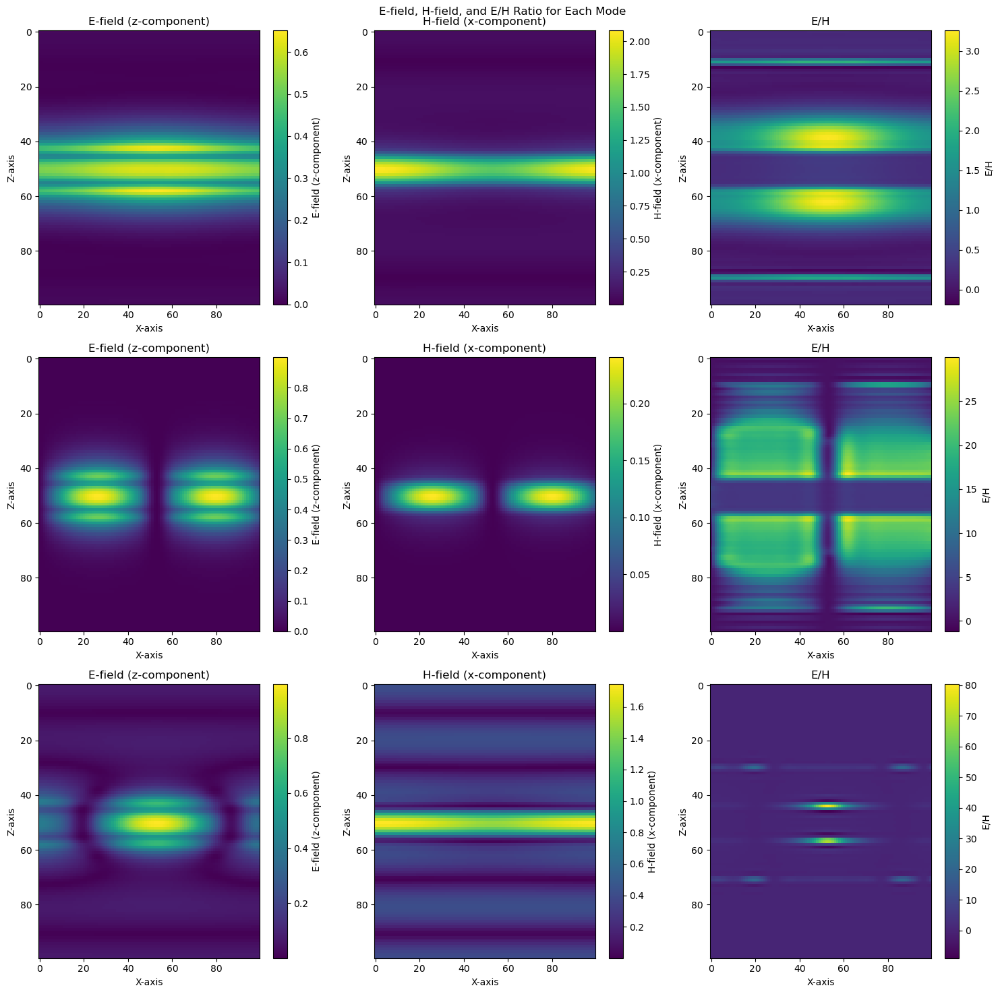

[{'Z_eff_z': MPBArray(0.76941359), 'eps_eff_z': MPBArray(96.34746255), 'mu_eff_z': MPBArray(-0.00040188), 'freq': 0.5807943478474249, 'k_point': Vector3<0.0, 0.1142857142857143, 0.0>}, {'Z_eff_z': MPBArray(7.47252847), 'eps_eff_z': MPBArray(9.17624586), 'mu_eff_z': MPBArray(-0.00361026), 'freq': 0.6278991492092693, 'k_point': Vector3<0.0, 0.1142857142857143, 0.0>}, {'Z_eff_z': MPBArray(0.47436232), 'eps_eff_z': MPBArray(141.22550603), 'mu_eff_z': MPBArray(-0.00022391), 'freq': 0.6426865151582245, 'k_point': Vector3<0.0, 0.1142857142857143, 0.0>}]


In [64]:
from scipy.interpolate import interp2d
import numpy as np

import matplotlib.pyplot as plt

fig, axs = plt.subplots(len(t_modes), 3, figsize=(15, 5 * len(t_modes)))
plottable_results = []


for i, mode in enumerate(t_modes):
    e_field_z = abs(mode["e_field"][..., 2])
    h_field_x = abs(mode["h_field"][..., 0])
    Z = e_field_z / h_field_x
    Z_eff_z = Z.mean()
    print(f"Z_eff_z: {Z_eff_z}")

    # Interpolate the data
    x = np.arange(e_field_z.shape[0])
    z = np.arange(e_field_z.shape[2])
    f_e_field_z = interp2d(x, z, e_field_z[:, 0, :].T, kind='cubic')
    f_h_field_x = interp2d(x, z, h_field_x[:, 0, :].T, kind='cubic')
    f_Z = interp2d(x, z, Z[:, 0, :].T, kind='cubic')

    x_new = np.linspace(0, e_field_z.shape[0] - 1, 100)
    z_new = np.linspace(0, e_field_z.shape[2] - 1, 100)

    e_field_z_interp = f_e_field_z(x_new, z_new)
    h_field_x_interp = f_h_field_x(x_new, z_new)
    Z_interp = f_Z(x_new, z_new)

    axs[i, 0].imshow(e_field_z_interp, cmap='viridis', aspect='auto')
    axs[i, 0].set_title("E-field (z-component)")
    axs[i, 0].set_xlabel("X-axis")
    axs[i, 0].set_ylabel("Z-axis")
    axs[i, 0].axis('on')
    cbar = fig.colorbar(axs[i, 0].images[0], ax=axs[i, 0])
    cbar.set_label('E-field (z-component)')

    axs[i, 1].imshow(h_field_x_interp, cmap='viridis', aspect='auto')
    axs[i, 1].set_title("H-field (x-component)")
    axs[i, 1].set_xlabel("X-axis")
    axs[i, 1].set_ylabel("Z-axis")
    axs[i, 1].axis('on')
    cbar = fig.colorbar(axs[i, 1].images[0], ax=axs[i, 1])
    cbar.set_label('H-field (x-component)')

    axs[i, 2].imshow(Z_interp, cmap='viridis', aspect='auto')
    axs[i, 2].set_title("E/H")
    axs[i, 2].set_xlabel("X-axis")
    axs[i, 2].set_ylabel("Z-axis")
    axs[i, 2].axis('off')
    cbar = fig.colorbar(axs[i, 2].images[0], ax=axs[i, 2])
    cbar.set_label('E/H')
    axs[i, 2].axis('on')
    
    
    epsilon_0 = 8.854187817e-12
    mu_0 = 4*np.pi*1e-7
    c0 = 299792458

    eps_eff_z = mode["k_point"][1]/Z_eff_z/epsilon_0/mode["freq"]/c0
    mu_eff_z = -mode["k_point"][1]*Z_eff_z/mu_0/mode["freq"]/c0

    plottable_results.append({
        "Z_eff_z": Z_eff_z,
        "eps_eff_z": eps_eff_z,
        "mu_eff_z": mu_eff_z,
        "freq": mode["freq"],
        "k_point": mode["k_point"],
    })

plt.suptitle("E-field, H-field, and E/H Ratio for Each Mode")
plt.tight_layout()
plt.show()

print(plottable_results)



In [ ]:


for i, mode in enumerate(t_modes):
    e_field_z = abs(mode["e_field"][..., 2])
    h_field_x = abs(mode["h_field"][..., 0])
    Z = e_field_z / h_field_x
    Z_eff_z = Z.mean()
    print(f"Z_eff_z: {Z_eff_z}")

    # Interpolate the data
    x = np.arange(e_field_z.shape[0])
    z = np.arange(e_field_z.shape[2])
    f_e_field_z = interp2d(x, z, e_field_z[:, 0, :].T, kind='cubic')
    f_h_field_x = interp2d(x, z, h_field_x[:, 0, :].T, kind='cubic')
    f_Z = interp2d(x, z, Z[:, 0, :].T, kind='cubic')

    x_new = np.linspace(0, e_field_z.shape[0] - 1, 100)
    z_new = np.linspace(0, e_field_z.shape[2] - 1, 100)

    e_field_z_interp = f_e_field_z(x_new, z_new)
    h_field_x_interp = f_h_field_x(x_new, z_new)
    Z_interp = f_Z(x_new, z_new)

    axs[i, 0].imshow(e_field_z_interp, cmap='viridis', aspect='auto')
    axs[i, 0].set_title("E-field (z-component)")
    axs[i, 0].set_xlabel("X-axis")
    axs[i, 0].set_ylabel("Z-axis")
    axs[i, 0].axis('on')
    cbar = fig.colorbar(axs[i, 0].images[0], ax=axs[i, 0])
    cbar.set_label('E-field (z-component)')

    axs[i, 1].imshow(h_field_x_interp, cmap='viridis', aspect='auto')
    axs[i, 1].set_title("H-field (x-component)")
    axs[i, 1].set_xlabel("X-axis")
    axs[i, 1].set_ylabel("Z-axis")
    axs[i, 1].axis('on')
    cbar = fig.colorbar(axs[i, 1].images[0], ax=axs[i, 1])
    cbar.set_label('H-field (x-component)')

    axs[i, 2].imshow(Z_interp, cmap='viridis', aspect='auto')
    axs[i, 2].set_title("E/H")
    axs[i, 2].set_xlabel("X-axis")
    axs[i, 2].set_ylabel("Z-axis")
    axs[i, 2].axis('off')
    cbar = fig.colorbar(axs[i, 2].images[0], ax=axs[i, 2])
    cbar.set_label('E/H')
    axs[i, 2].axis('on')
    
    
    epsilon_0 = 8.854187817e-12
    mu_0 = 4*np.pi*1e-7
    c0 = 299792458

    eps_eff_z = mode["k_point"][1]/Z_eff_z/epsilon_0/mode["freq"]/c0
    mu_eff_z = -mode["k_point"][1]*Z_eff_z/mu_0/mode["freq"]/c0

    plottable_results.append({
        "Z_eff_z": Z_eff_z,
        "eps_eff_z": eps_eff_z,
        "mu_eff_z": mu_eff_z,
        "freq": mode["freq"],
        "k_point": mode["k_point"],
    })

plt.suptitle("E-field, H-field, and E/H Ratio for Each Mode")
plt.tight_layout()
plt.show()

print(plottable_results)



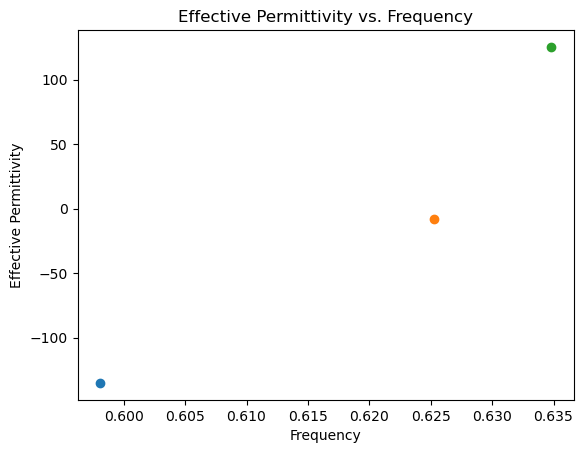

In [100]:
for plottable_result in plottable_results:
    plt.plot(plottable_result["freq"], plottable_result["eps_eff_z"], 'o', label=f'k={plottable_result["k_point"]}')

plt.xlabel("Frequency")
plt.ylabel("Effective Permittivity")
plt.title("Effective Permittivity vs. Frequency")
plt.show()  

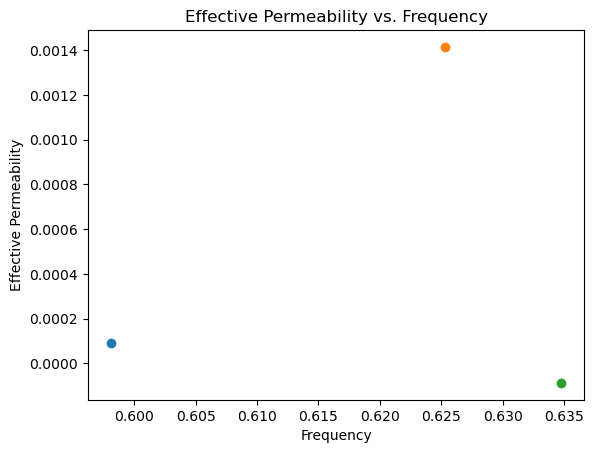

In [101]:

for plottable_result in plottable_results:
    plt.plot(plottable_result["freq"], plottable_result["mu_eff_z"], 'o', label=f'k={plottable_result["k_point"]}')

plt.xlabel("Frequency")
plt.ylabel("Effective Permeability")
plt.title("Effective Permeability vs. Frequency")
plt.show()  


In [110]:
def look_for_mode(self, polarization, k_point, freq, k_point_max_distance = None, freq_tolerance=0.01):
        """
        Look for a mode with the specified polarization, k-point, and frequency.

        Args:
            polarization (str): The polarization of the mode.
            k_point (tuple): The k-point of the mode.
            freq (float): The frequency of the mode.
            freq_tolerance (float): The tolerance for frequency similarity.

        Returns:
            list: A list of mode dictionaries that match the criteria.
        """

        target_modes = []
        if k_point_max_distance is None:
            for mode in self.modes:
                if mode["polarization"] == polarization and mode["k_point"] == k_point and abs(mode["freq"] - freq) <= freq_tolerance:
                    target_modes.append(mode)
        else:
            for mode in self.modes:
                if mode["polarization"] == polarization and np.linalg.norm(np.array(mode["k_point"]) - np.array(k_point)) <= k_point_max_distance and abs(mode["freq"] - freq) <= freq_tolerance:
                    target_modes.append(mode)
        return target_modes

modes = look_for_mode(slab, "zodd", mp.Vector3(0.0, 0,0.0), 0.62, k_point_max_distance=0.5, freq_tolerance=0.05)

In [111]:
print(len(modes))
for mode in modes:
    print(f'k:{mode["k_point"]} freq:{mode["freq"]}')
    

32
k:Vector3<0.4, 0.0, 0.0> freq:0.5748734214067649
k:Vector3<0.4, 0.0, 0.0> freq:0.6022540040627357
k:Vector3<0.4, 0.0, 0.0> freq:0.6155369703039258
k:Vector3<0.33333333333333337, 0.0, 0.0> freq:0.6317299207587376
k:Vector3<0.33333333333333337, 0.0, 0.0> freq:0.6466484333023529
k:Vector3<0.2666666666666667, 0.0, 0.0> freq:0.6371081848509794
k:Vector3<0.2666666666666667, 0.0, 0.0> freq:0.6414149590107423
k:Vector3<0.2, 0.0, 0.0> freq:0.6319614530303643
k:Vector3<0.2, 0.0, 0.0> freq:0.6368107901266823
k:Vector3<0.13333333333333336, 0.0, 0.0> freq:0.5819317737267085
k:Vector3<0.13333333333333336, 0.0, 0.0> freq:0.6271971749259264
k:Vector3<0.13333333333333336, 0.0, 0.0> freq:0.6330797361714969
k:Vector3<0.06666666666666671, 0.0, 0.0> freq:0.6041008653189076
k:Vector3<0.06666666666666671, 0.0, 0.0> freq:0.6237723545197122
k:Vector3<0.06666666666666671, 0.0, 0.0> freq:0.629041795645648
k:Vector3<0.0, 0.0, 0.0> freq:0.6169334725080908
k:Vector3<0.0, 0.0, 0.0> freq:0.622501661867139
k:Vector

Let's conisder the modes along y


Z_eff_z: -0.3110606451011473
Z_eff_z: -5.001124544331361
Z_eff_z: 0.31584914014027643
Z_eff_z: -0.35443778496301315
Z_eff_z: -3.8339924966589765
Z_eff_z: -1.1852441385768107
Z_eff_z: 4.49786684280156
Z_eff_z: 1.3247491400312508
Z_eff_z: 3.006992377991494
Z_eff_z: 0.6662826483037011
Z_eff_z: 2.1540062700866707
Z_eff_z: 12.65355711503421
Z_eff_z: -5.1811726499213435
Z_eff_z: -1.0521399161803306


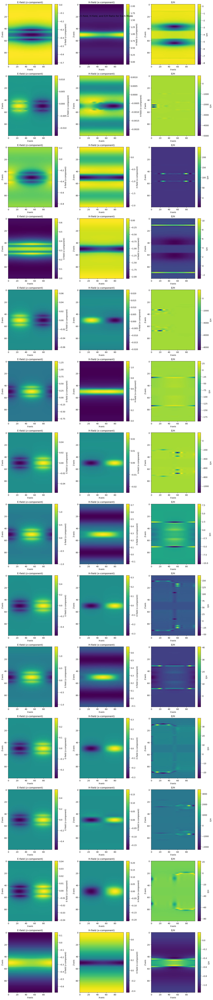

[{'Z_eff_z': MPBArray(-0.31106065), 'eps_eff_z': MPBArray(-135.00114536), 'mu_eff_z': MPBArray(9.20378481e-05), 'freq': 0.5980765665247294, 'k_point': Vector3<0.0, 0.06666666666666667, 0.0>}, {'Z_eff_z': MPBArray(-5.00112454), 'eps_eff_z': MPBArray(-8.03158781), 'mu_eff_z': MPBArray(0.00141539), 'freq': 0.6252737923172338, 'k_point': Vector3<0.0, 0.06666666666666667, 0.0>}, {'Z_eff_z': MPBArray(0.31584914), 'eps_eff_z': MPBArray(125.26485358), 'mu_eff_z': MPBArray(-8.80496226e-05), 'freq': 0.6347904345712638, 'k_point': Vector3<0.0, 0.06666666666666667, 0.0>}, {'Z_eff_z': MPBArray(-0.35443778), 'eps_eff_z': MPBArray(-247.06694308), 'mu_eff_z': MPBArray(0.00021869), 'freq': 0.5736072712711286, 'k_point': Vector3<0.0, 0.13333333333333333, 0.0>}, {'Z_eff_z': MPBArray(-3.8339925), 'eps_eff_z': MPBArray(-20.8202347), 'mu_eff_z': MPBArray(0.00215639), 'freq': 0.6292633300080531, 'k_point': Vector3<0.0, 0.13333333333333333, 0.0>}, {'Z_eff_z': MPBArray(-1.18524414), 'eps_eff_z': MPBArray(-65.7

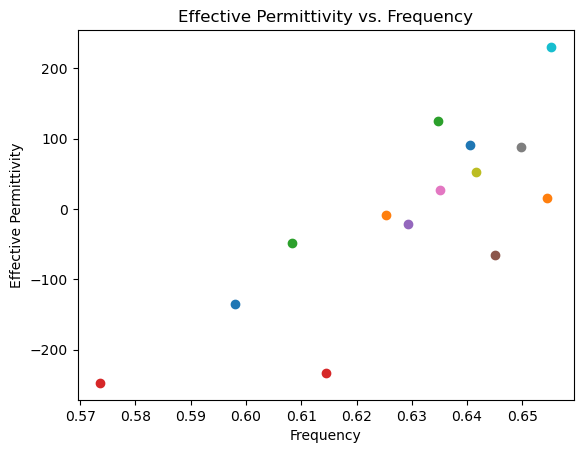

In [114]:
from scipy.interpolate import interp2d
import numpy as np

import matplotlib.pyplot as plt

t_modes = []
for mode in modes:
    if mode["k_point"][1] != 0:
        t_modes.append(mode)
len(t_modes)


fig, axs = plt.subplots(len(t_modes), 3, figsize=(15, 5 * len(t_modes)))
plottable_results = []


for i, mode in enumerate(t_modes):
    e_field_z = mode["e_field"][..., 2].real
    h_field_x = mode["h_field"][..., 0].real
    Z = e_field_z / h_field_x
    Z_eff_z = Z.mean()
    print(f"Z_eff_z: {Z_eff_z}")

    # Interpolate the data
    x = np.arange(e_field_z.shape[0])
    z = np.arange(e_field_z.shape[2])
    f_e_field_z = interp2d(x, z, e_field_z[:, 0, :].T, kind='cubic')
    f_h_field_x = interp2d(x, z, h_field_x[:, 0, :].T, kind='cubic')
    f_Z = interp2d(x, z, Z[:, 0, :].T, kind='cubic')

    x_new = np.linspace(0, e_field_z.shape[0] - 1, 100)
    z_new = np.linspace(0, e_field_z.shape[2] - 1, 100)

    e_field_z_interp = f_e_field_z(x_new, z_new)
    h_field_x_interp = f_h_field_x(x_new, z_new)
    Z_interp = f_Z(x_new, z_new)

    axs[i, 0].imshow(e_field_z_interp, cmap='viridis', aspect='auto')
    axs[i, 0].set_title("E-field (z-component)")
    axs[i, 0].set_xlabel("X-axis")
    axs[i, 0].set_ylabel("Z-axis")
    axs[i, 0].axis('on')
    cbar = fig.colorbar(axs[i, 0].images[0], ax=axs[i, 0])
    cbar.set_label('E-field (z-component)')

    axs[i, 1].imshow(h_field_x_interp, cmap='viridis', aspect='auto')
    axs[i, 1].set_title("H-field (x-component)")
    axs[i, 1].set_xlabel("X-axis")
    axs[i, 1].set_ylabel("Z-axis")
    axs[i, 1].axis('on')
    cbar = fig.colorbar(axs[i, 1].images[0], ax=axs[i, 1])
    cbar.set_label('H-field (x-component)')

    axs[i, 2].imshow(Z_interp, cmap='viridis', aspect='auto')
    axs[i, 2].set_title("E/H")
    axs[i, 2].set_xlabel("X-axis")
    axs[i, 2].set_ylabel("Z-axis")
    axs[i, 2].axis('off')
    cbar = fig.colorbar(axs[i, 2].images[0], ax=axs[i, 2])
    cbar.set_label('E/H')
    axs[i, 2].axis('on')
    
    
    epsilon_0 = 8.854187817e-12
    mu_0 = 4*np.pi*1e-7
    c0 = 299792458

    eps_eff_z = mode["k_point"][1]/Z_eff_z/epsilon_0/mode["freq"]/c0
    mu_eff_z = -mode["k_point"][1]*Z_eff_z/mu_0/mode["freq"]/c0

    plottable_results.append({
        "Z_eff_z": Z_eff_z,
        "eps_eff_z": eps_eff_z,
        "mu_eff_z": mu_eff_z,
        "freq": mode["freq"],
        "k_point": mode["k_point"],
    })

plt.suptitle("E-field, H-field, and E/H Ratio for Each Mode")
plt.tight_layout()
plt.show()

print(plottable_results)
for plottable_result in plottable_results:
    plt.plot(plottable_result["freq"], plottable_result["eps_eff_z"], 'o', label=f'k={plottable_result["k_point"]}')

plt.xlabel("Frequency")
plt.ylabel("Effective Permittivity")
plt.title("Effective Permittivity vs. Frequency")
plt.show()  

Now we use the imaginary part also


Z_eff_z: (-0.7611645897600178+0.02361804310450142j)
Z_eff_z: (0.6421092818065013+0.727621138841599j)
Z_eff_z: (0.7557266040591838+0.08723496925111379j)
Z_eff_z: (-0.7963502789560115+0.032537772153997606j)
Z_eff_z: (0.42875941836554626+0.870863110665646j)
Z_eff_z: (1.8372844535284973+0.6318834291004696j)
Z_eff_z: (0.5378080298842237+0.292397015485646j)
Z_eff_z: (1.9686904334189772+0.5751248855956702j)
Z_eff_z: (0.08589551567993461+0.008095870163880137j)
Z_eff_z: (1.3588255001673477+0.20599269071046944j)
Z_eff_z: (-0.8575405287208674-0.6586871086152047j)
Z_eff_z: (-0.8673388201474201+0.5063953866350615j)
Z_eff_z: (-0.589852761381787-0.3228420185663644j)
Z_eff_z: (-1.010802031130778-0.003154094410771856j)


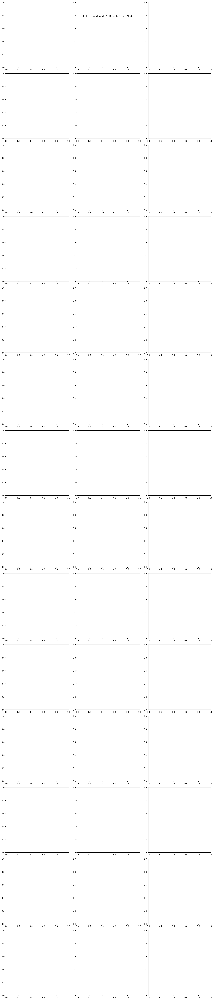

[{'Z_eff_z': MPBArray(-0.76116459+0.02361804j), 'eps_eff_z': MPBArray(-55.11705607-1.71021751j), 'mu_eff_z': MPBArray(0.00022522-6.98819956e-06j), 'freq': 0.5980765665247294, 'k_point': Vector3<0.0, 0.06666666666666667, 0.0>}, {'Z_eff_z': MPBArray(0.64210928+0.72762114j), 'eps_eff_z': MPBArray(27.3872524-31.0345051j), 'mu_eff_z': MPBArray(-0.00018173-0.00020593j), 'freq': 0.6252737923172338, 'k_point': Vector3<0.0, 0.06666666666666667, 0.0>}, {'Z_eff_z': MPBArray(0.7557266+0.08723497j), 'eps_eff_z': MPBArray(51.66490894-5.96377939j), 'mu_eff_z': MPBArray(-0.00021067-2.43185912e-05j), 'freq': 0.6347904345712638, 'k_point': Vector3<0.0, 0.06666666666666667, 0.0>}, {'Z_eff_z': MPBArray(-0.79635028+0.03253777j), 'eps_eff_z': MPBArray(-109.78072657-4.48548881j), 'mu_eff_z': MPBArray(0.00049136-2.00761918e-05j), 'freq': 0.5736072712711286, 'k_point': Vector3<0.0, 0.13333333333333333, 0.0>}, {'Z_eff_z': MPBArray(0.42875942+0.87086311j), 'eps_eff_z': MPBArray(36.32371904-73.77794072j), 'mu_eff

/usr/lib/python3/dist-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning:

Casting complex values to real discards the imaginary part



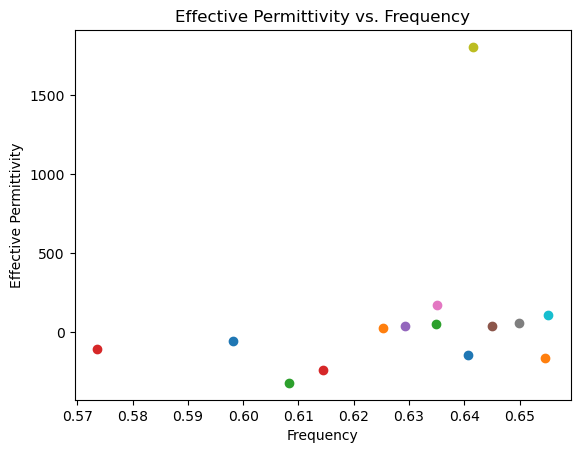

In [119]:
from scipy.interpolate import interp2d
import numpy as np

import matplotlib.pyplot as plt

t_modes = []
for mode in modes:
    if mode["k_point"][1] != 0:
        t_modes.append(mode)
len(t_modes)


fig, axs = plt.subplots(len(t_modes), 3, figsize=(15, 5 * len(t_modes)))
plottable_results = []


for i, mode in enumerate(t_modes):
    e_field_z = (mode["e_field"][..., 2])
    h_field_x = (mode["h_field"][..., 0])
    Z = e_field_z.mean() / h_field_x.mean()
    Z_eff_z = Z.mean()
    print(f"Z_eff_z: {Z_eff_z}")

    # # Interpolate the data
    # x = np.arange(e_field_z.shape[0])
    # z = np.arange(e_field_z.shape[2])
    # f_e_field_z = interp2d(x, z, e_field_z[:, 0, :].T, kind='cubic')
    # f_h_field_x = interp2d(x, z, h_field_x[:, 0, :].T, kind='cubic')
    # f_Z = interp2d(x, z, Z[:, 0, :].T, kind='cubic')

    # x_new = np.linspace(0, e_field_z.shape[0] - 1, 100)
    # z_new = np.linspace(0, e_field_z.shape[2] - 1, 100)

    # e_field_z_interp = f_e_field_z(x_new, z_new)
    # h_field_x_interp = f_h_field_x(x_new, z_new)
    # Z_interp = f_Z(x_new, z_new)

    # axs[i, 0].imshow(e_field_z_interp, cmap='viridis', aspect='auto')
    # axs[i, 0].set_title("E-field (z-component)")
    # axs[i, 0].set_xlabel("X-axis")
    # axs[i, 0].set_ylabel("Z-axis")
    # axs[i, 0].axis('on')
    # cbar = fig.colorbar(axs[i, 0].images[0], ax=axs[i, 0])
    # cbar.set_label('E-field (z-component)')

    # axs[i, 1].imshow(h_field_x_interp, cmap='viridis', aspect='auto')
    # axs[i, 1].set_title("H-field (x-component)")
    # axs[i, 1].set_xlabel("X-axis")
    # axs[i, 1].set_ylabel("Z-axis")
    # axs[i, 1].axis('on')
    # cbar = fig.colorbar(axs[i, 1].images[0], ax=axs[i, 1])
    # cbar.set_label('H-field (x-component)')

    # axs[i, 2].imshow(Z_interp, cmap='viridis', aspect='auto')
    # axs[i, 2].set_title("E/H")
    # axs[i, 2].set_xlabel("X-axis")
    # axs[i, 2].set_ylabel("Z-axis")
    # axs[i, 2].axis('off')
    # cbar = fig.colorbar(axs[i, 2].images[0], ax=axs[i, 2])
    # cbar.set_label('E/H')
    # axs[i, 2].axis('on')
    
    
    epsilon_0 = 8.854187817e-12
    mu_0 = 4*np.pi*1e-7
    c0 = 299792458

    eps_eff_z = mode["k_point"][1]/Z_eff_z/epsilon_0/mode["freq"]/c0
    mu_eff_z = -mode["k_point"][1]*Z_eff_z/mu_0/mode["freq"]/c0

    plottable_results.append({
        "Z_eff_z": Z_eff_z,
        "eps_eff_z": eps_eff_z,
        "mu_eff_z": mu_eff_z,
        "freq": mode["freq"],
        "k_point": mode["k_point"],
    })

plt.suptitle("E-field, H-field, and E/H Ratio for Each Mode")
plt.tight_layout()
plt.show()

print(plottable_results)
for plottable_result in plottable_results:
    plt.plot(plottable_result["freq"], plottable_result["eps_eff_z"], 'o', label=f'k={plottable_result["k_point"]}')

plt.xlabel("Frequency")
plt.ylabel("Effective Permittivity")
plt.title("Effective Permittivity vs. Frequency")
plt.show()  